In [29]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import seaborn as sns
import numpy as np

In [2]:
df=pd.read_csv('train.csv')
df

,id,main.pos,fun.pos,when,y,E1A1,E1A2,E1A3,E1A4,E1A5,...,M2V2039,M2V2040,M2V2041,M2V2042,M2V2043,M2V2044,M2V2045,M2V2046,M2V2047,M2V2048
0,1,LHCB-P18,QSCB-18-C2,2017-06,1,-0.576589,-0.951065,0.944338,-0.086406,0.253089,...,-0.017011,-0.101842,0.027109,0.168339,0.152390,0.000410,-0.126250,0.072403,0.214993,0.184996
1,2,LHCB-6,QSCB-6-CP6,2018-09,1,0.970694,1.524991,1.813341,0.447012,-1.038631,...,0.106717,-0.057328,-0.146602,0.069251,0.351492,0.106101,0.192691,0.167834,-0.170475,-0.236751
2,3,LHCB-8,QSCB-8-CP7,2022-11,1,1.065262,0.461292,0.416869,0.460564,-0.019386,...,0.198017,-0.044788,0.011786,-0.037881,-0.152690,-0.104267,0.037444,0.489454,0.268134,-0.117367
3,4,LHCB-8,QSCB-8-CP1,2023-04,1,-0.341942,0.614190,0.904430,0.727268,0.187494,...,0.168140,-0.071131,0.067982,-0.023509,-0.028273,0.000943,-0.018128,0.013366,0.015902,0.043247
4,5,LHCB-P18,QSCB-18-C1,2017-04,1,-0.569563,0.368497,-0.269832,-0.179988,-0.065328,...,0.082521,0.105978,0.020868,0.173724,-0.037431,0.147695,0.038233,-0.047549,0.101227,-0.109760
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
658,1012,LHCB-4,QSCB-4-CP1,2019-03,1,-0.094653,-0.273495,0.927676,-0.244089,0.394102,...,0.076421,-0.017458,0.113222,0.081531,-0.118022,-0.068159,-0.160683,-0.054098,-0.043842,0.079474
659,1013,LHCB-6,QSCB-6-CP1,2022-05,1,-0.447106,-0.074231,0.331543,0.150676,-0.050445,...,0.137185,0.240015,0.169615,0.068595,0.097196,-0.020113,-0.010522,0.063634,0.096408,-0.085637
660,1014,LHCB-P18,QSCB-18-C2,2018-04,1,0.264532,1.554129,-1.447155,0.442756,2.655931,...,-0.037920,0.087096,-0.399536,-0.121802,-0.027615,-0.190010,-0.099357,-0.026138,-0.008852,-0.108788
661,1015,LHCB-4,QSCB-4-CP7,2017-01,1,-0.522473,-0.007026,0.361770,-0.630256,-0.851504,...,-0.256542,-0.215720,-0.006428,0.037543,0.120194,0.155707,0.156359,0.280801,0.155129,0.176686


In [3]:
df['main.pos'].nunique()

4

In [4]:
df['fun.pos'].unique()

array(['QSCB-18-C2', 'QSCB-6-CP6', 'QSCB-8-CP7', 'QSCB-8-CP1',
       'QSCB-18-C1', 'QSCB-8-CP2', 'QSCB-6-CP2', 'QSCB-4-CP6',
       'QSCB-6-CP1', 'QSCB-18-C3', 'QSCB-18-C7', 'QSCB-4-CP2',
       'QSCB-6-CP3', 'QSCB-8-CP3', 'QSCB-6-CP7', 'QSCB-4-CP7',
       'QSCB-4-CP1', 'QSCB-18-C6', 'QSCB-4-CP3', 'QSCB-8-CP6'],
      dtype=object)

In [5]:
### Number of time series of each individual unit
c=Counter(df['main.pos']+' '+df['fun.pos'])
c

Counter({'LHCB-P18 QSCB-18-C2': 42,
         'LHCB-6 QSCB-6-CP6': 35,
         'LHCB-8 QSCB-8-CP7': 38,
         'LHCB-8 QSCB-8-CP1': 33,
         'LHCB-P18 QSCB-18-C1': 33,
         'LHCB-8 QSCB-8-CP2': 29,
         'LHCB-6 QSCB-6-CP2': 37,
         'LHCB-4 QSCB-4-CP6': 32,
         'LHCB-6 QSCB-6-CP1': 34,
         'LHCB-P18 QSCB-18-C3': 37,
         'LHCB-P18 QSCB-18-C7': 42,
         'LHCB-4 QSCB-4-CP2': 29,
         'LHCB-6 QSCB-6-CP3': 25,
         'LHCB-8 QSCB-8-CP3': 30,
         'LHCB-6 QSCB-6-CP7': 34,
         'LHCB-4 QSCB-4-CP7': 28,
         'LHCB-4 QSCB-4-CP1': 31,
         'LHCB-P18 QSCB-18-C6': 31,
         'LHCB-4 QSCB-4-CP3': 36,
         'LHCB-8 QSCB-8-CP6': 27})

In [6]:
keys=df['main.pos']+' '+df['fun.pos']

<AxesSubplot:>

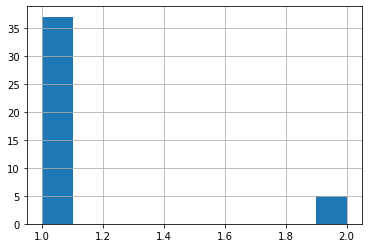

In [7]:
l=list(c.keys())

df.loc[keys[keys==l[0]].index,:].y.hist()

In [8]:
df_2=df.groupby(by=['main.pos','fun.pos','y']).mean()
df_2

id      E1A1      E1A2      E1A3      E1A4  \
main.pos fun.pos    y                                                       
LHCB-4   QSCB-4-CP1 1  526.677419  0.473477  0.431791  0.166970  0.244623   
         QSCB-4-CP2 1  523.750000 -0.004708 -0.031715 -0.080441 -0.112394   
                    2  108.000000 -1.923729 -0.233395 -0.930188 -0.334518   
         QSCB-4-CP3 1  610.771429  0.056524  0.064281 -0.018780  0.069386   
                    2  641.000000 -1.313339  0.413958 -0.340979  0.145874   
         QSCB-4-CP6 1  568.806452 -0.027534 -0.024504 -0.070535 -0.124754   
                    2  729.000000  1.524503  0.297842 -0.055989 -1.030053   
         QSCB-4-CP7 1  575.500000 -0.047648  0.276930  0.182978  0.068586   
LHCB-6   QSCB-6-CP1 1  478.406250  0.034391  0.275674  0.188777  0.040643   
                    2  525.500000 -0.520860  0.287375 -0.019181 -0.838599   
         QSCB-6-CP2 1  370.346154 -0.052126  0.078449  0.101601  0.134443   
                    2  437.545455  0.005879  0.087414  0.156586  0.131836   
         QSCB-6-CP3 1  455.360000 -0.149145 -0.005151  0.105146  0.243369   
         QSCB-6-CP6 1  485.428571 -0.010304 -0.013552 -0.128704 -0.305098   
         QSCB-6-CP7 1  533.333333 -0.179061 -0.189679 -0.105294  0.165469   
                    2  713.000000  0.072663 -0.467993  0.413049  1.067614   
                    3  472.333333  1.502797 -0.796982  0.581797  0.321994   
LHCB-8   QSCB-8-CP1 1  484.290323 -0.080809 -0.143271 -0.123264  0.204395   
                    2  744.000000  0.195525 -0.109979 -0.325056 -0.532414   
                    3  885.000000 -0.685269  0.234567 -0.149447 -0.076372   
         QSCB-8-CP2 1  556.185185 -0.145059 -0.177698 -0.142549 -0.014826   
                    2  306.000000 -0.069571 -0.294788  0.326811  0.452356   
         QSCB-8-CP3 1  501.633333  0.135573  0.051256 -0.152410 -0.104585   
         QSCB-8-CP6 1  401.210526 -0.063982 -0.259744 -0.228543 -0.115749   
                    2  499.000000 -0.173515  0.093549  0.285624  0.026684   
         QSCB-8-CP7 1  522.823529 -0.137232 -0.068490  0.229772  0.189036   
                    2  770.250000 -1.379520 -0.988985 -0.797583 -0.876204   
LHCB-P18 QSCB-18-C1 1  481.242424 -0.106838 -0.019882  0.215578  0.286332   
         QSCB-18-C2 1  534.351351  0.012914 -0.341304 -0.225958  0.050721   
                    2  590.000000 -1.397620 -0.014110  0.300866 -0.590105   
         QSCB-18-C3 1  493.027778  0.137133 -0.011933 -0.064845 -0.009062   
                    2  505.000000 -0.505678 -0.160567 -0.187687 -0.489919   
         QSCB-18-C6 1  550.322581 -0.092243  0.285226 -0.243447 -0.410856   
         QSCB-18-C7 1  501.341463  0.108628  0.160599  0.020455 -0.121819   
                    2  675.000000  1.198190 -0.562453 -0.509137  0.635927   

                           E1A5      E1A6      E1A7      E1A8      E1A9  ...  \
main.pos fun.pos    y                                                    ...   
LHCB-4   QSCB-4-CP1 1  0.099376  0.003753 -0.559223 -0.225505 -0.168372  ...   
         QSCB-4-CP2 1 -0.070905 -0.023779  0.057110  0.095892  0.054590  ...   
                    2  0.268439  0.804236 -1.160246 -1.011909 -2.526402  ...   
         QSCB-4-CP3 1  0.051141 -0.086549 -0.080330 -0.174786 -0.163426  ...   
                    2 -0.362913  0.013012  1.361248  0.707359  1.069773  ...   
         QSCB-4-CP6 1 -0.287366 -0.282187 -0.476561 -0.296227 -0.065327  ...   
                    2 -1.840232 -0.221418  0.434916  2.499593  3.745780  ...   
         QSCB-4-CP7 1  0.177389  0.072825  0.145456  0.332247  0.204483  ...   
LHCB-6   QSCB-6-CP1 1 -0.176118 -0.107276 -0.168042 -0.193994  0.118205  ...   
                    2  1.550559 -0.331965 -0.291940  0.131244  0.743894  ...   
         QSCB-6-CP2 1  0.100711 -0.077022 -0.009106 -0.059142 -0.251572  ...   
                    2 -0.225040 -0.258801 -0.129851 -0.142533  0.070810  ...   
         QSCB-6-CP3 1  0.303900  0.136548 -0.037029 -0.129845

In [9]:
id=list(df_2.index)

id=[i[0]+','+i[1] for i in id]

c1=Counter(id)




In [10]:
### id with count greather than 1

id_1=[k for k,v in c1.items() if v>1]
id_1=[ tuple(i.split(','))  for i in id_1]
id_1

[('LHCB-4', 'QSCB-4-CP2'),
 ('LHCB-4', 'QSCB-4-CP3'),
 ('LHCB-4', 'QSCB-4-CP6'),
 ('LHCB-6', 'QSCB-6-CP1'),
 ('LHCB-6', 'QSCB-6-CP2'),
 ('LHCB-6', 'QSCB-6-CP7'),
 ('LHCB-8', 'QSCB-8-CP1'),
 ('LHCB-8', 'QSCB-8-CP2'),
 ('LHCB-8', 'QSCB-8-CP6'),
 ('LHCB-8', 'QSCB-8-CP7'),
 ('LHCB-P18', 'QSCB-18-C2'),
 ('LHCB-P18', 'QSCB-18-C3'),
 ('LHCB-P18', 'QSCB-18-C7')]

In [11]:
len(id_1)

13

In [41]:
x=df_2.loc[(id_1[0]),df_2.columns[1::]]
x

,E1A1,E1A2,E1A3,E1A4,E1A5,E1A6,E1A7,E1A8,E1A9,E1A10,...,M2V2039,M2V2040,M2V2041,M2V2042,M2V2043,M2V2044,M2V2045,M2V2046,M2V2047,M2V2048
y,,,,,,,,,,,,,,,,,,,,,
1,-0.004708,-0.031715,-0.080441,-0.112394,-0.070905,-0.023779,0.057110,0.095892,0.054590,0.008822,...,-0.008467,0.034058,0.075859,0.054737,0.020403,0.020816,0.032297,0.064164,0.029558,-0.018550
2,-1.923729,-0.233395,-0.930188,-0.334518,0.268439,0.804236,-1.160246,-1.011909,-2.526402,-0.978205,...,-0.380091,0.004535,0.004462,-0.290558,-0.531270,-0.338329,-0.067551,0.095053,-0.309445,-0.024472


In [117]:
df_2

id      E1A1      E1A2      E1A3      E1A4  \
main.pos fun.pos    y                                                       
LHCB-4   QSCB-4-CP1 1  526.677419  0.473477  0.431791  0.166970  0.244623   
         QSCB-4-CP2 1  523.750000 -0.004708 -0.031715 -0.080441 -0.112394   
                    2  108.000000 -1.923729 -0.233395 -0.930188 -0.334518   
         QSCB-4-CP3 1  610.771429  0.056524  0.064281 -0.018780  0.069386   
                    2  641.000000 -1.313339  0.413958 -0.340979  0.145874   
         QSCB-4-CP6 1  568.806452 -0.027534 -0.024504 -0.070535 -0.124754   
                    2  729.000000  1.524503  0.297842 -0.055989 -1.030053   
         QSCB-4-CP7 1  575.500000 -0.047648  0.276930  0.182978  0.068586   
LHCB-6   QSCB-6-CP1 1  478.406250  0.034391  0.275674  0.188777  0.040643   
                    2  525.500000 -0.520860  0.287375 -0.019181 -0.838599   
         QSCB-6-CP2 1  370.346154 -0.052126  0.078449  0.101601  0.134443   
                    2  437.545455  0.005879  0.087414  0.156586  0.131836   
         QSCB-6-CP3 1  455.360000 -0.149145 -0.005151  0.105146  0.243369   
         QSCB-6-CP6 1  485.428571 -0.010304 -0.013552 -0.128704 -0.305098   
         QSCB-6-CP7 1  533.333333 -0.179061 -0.189679 -0.105294  0.165469   
                    2  713.000000  0.072663 -0.467993  0.413049  1.067614   
                    3  472.333333  1.502797 -0.796982  0.581797  0.321994   
LHCB-8   QSCB-8-CP1 1  484.290323 -0.080809 -0.143271 -0.123264  0.204395   
                    2  744.000000  0.195525 -0.109979 -0.325056 -0.532414   
                    3  885.000000 -0.685269  0.234567 -0.149447 -0.076372   
         QSCB-8-CP2 1  556.185185 -0.145059 -0.177698 -0.142549 -0.014826   
                    2  306.000000 -0.069571 -0.294788  0.326811  0.452356   
         QSCB-8-CP3 1  501.633333  0.135573  0.051256 -0.152410 -0.104585   
         QSCB-8-CP6 1  401.210526 -0.063982 -0.259744 -0.228543 -0.115749   
                    2  499.000000 -0.173515  0.093549  0.285624  0.026684   
         QSCB-8-CP7 1  522.823529 -0.137232 -0.068490  0.229772  0.189036   
                    2  770.250000 -1.379520 -0.988985 -0.797583 -0.876204   
LHCB-P18 QSCB-18-C1 1  481.242424 -0.106838 -0.019882  0.215578  0.286332   
         QSCB-18-C2 1  534.351351  0.012914 -0.341304 -0.225958  0.050721   
                    2  590.000000 -1.397620 -0.014110  0.300866 -0.590105   
         QSCB-18-C3 1  493.027778  0.137133 -0.011933 -0.064845 -0.009062   
                    2  505.000000 -0.505678 -0.160567 -0.187687 -0.489919   
         QSCB-18-C6 1  550.322581 -0.092243  0.285226 -0.243447 -0.410856   
         QSCB-18-C7 1  501.341463  0.108628  0.160599  0.020455 -0.121819   
                    2  675.000000  1.198190 -0.562453 -0.509137  0.635927   

                           E1A5      E1A6      E1A7      E1A8      E1A9  ...  \
main.pos fun.pos    y                                                    ...   
LHCB-4   QSCB-4-CP1 1  0.099376  0.003753 -0.559223 -0.225505 -0.168372  ...   
         QSCB-4-CP2 1 -0.070905 -0.023779  0.057110  0.095892  0.054590  ...   
                    2  0.268439  0.804236 -1.160246 -1.011909 -2.526402  ...   
         QSCB-4-CP3 1  0.051141 -0.086549 -0.080330 -0.174786 -0.163426  ...   
                    2 -0.362913  0.013012  1.361248  0.707359  1.069773  ...   
         QSCB-4-CP6 1 -0.287366 -0.282187 -0.476561 -0.296227 -0.065327  ...   
                    2 -1.840232 -0.221418  0.434916  2.499593  3.745780  ...   
         QSCB-4-CP7 1  0.177389  0.072825  0.145456  0.332247  0.204483  ...   
LHCB-6   QSCB-6-CP1 1 -0.176118 -0.107276 -0.168042 -0.193994  0.118205  ...   
                    2  1.550559 -0.331965 -0.291940  0.131244  0.743894  ...   
         QSCB-6-CP2 1  0.100711 -0.077022 -0.009106 -0.059142 -0.251572  ...   
                    2 -0.225040 -0.258801 -0.129851 -0.142533  0.070810  ...   
         QSCB-6-CP3 1  0.303900  0.136548 -0.037029 -0.129845

In [118]:
df

,id,main.pos,fun.pos,when,y,E1A1,E1A2,E1A3,E1A4,E1A5,...,M2V2039,M2V2040,M2V2041,M2V2042,M2V2043,M2V2044,M2V2045,M2V2046,M2V2047,M2V2048
0,1,LHCB-P18,QSCB-18-C2,2017-06,1,-0.576589,-0.951065,0.944338,-0.086406,0.253089,...,-0.017011,-0.101842,0.027109,0.168339,0.152390,0.000410,-0.126250,0.072403,0.214993,0.184996
1,2,LHCB-6,QSCB-6-CP6,2018-09,1,0.970694,1.524991,1.813341,0.447012,-1.038631,...,0.106717,-0.057328,-0.146602,0.069251,0.351492,0.106101,0.192691,0.167834,-0.170475,-0.236751
2,3,LHCB-8,QSCB-8-CP7,2022-11,1,1.065262,0.461292,0.416869,0.460564,-0.019386,...,0.198017,-0.044788,0.011786,-0.037881,-0.152690,-0.104267,0.037444,0.489454,0.268134,-0.117367
3,4,LHCB-8,QSCB-8-CP1,2023-04,1,-0.341942,0.614190,0.904430,0.727268,0.187494,...,0.168140,-0.071131,0.067982,-0.023509,-0.028273,0.000943,-0.018128,0.013366,0.015902,0.043247
4,5,LHCB-P18,QSCB-18-C1,2017-04,1,-0.569563,0.368497,-0.269832,-0.179988,-0.065328,...,0.082521,0.105978,0.020868,0.173724,-0.037431,0.147695,0.038233,-0.047549,0.101227,-0.109760
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
658,1012,LHCB-4,QSCB-4-CP1,2019-03,1,-0.094653,-0.273495,0.927676,-0.244089,0.394102,...,0.076421,-0.017458,0.113222,0.081531,-0.118022,-0.068159,-0.160683,-0.054098,-0.043842,0.079474
659,1013,LHCB-6,QSCB-6-CP1,2022-05,1,-0.447106,-0.074231,0.331543,0.150676,-0.050445,...,0.137185,0.240015,0.169615,0.068595,0.097196,-0.020113,-0.010522,0.063634,0.096408,-0.085637
660,1014,LHCB-P18,QSCB-18-C2,2018-04,1,0.264532,1.554129,-1.447155,0.442756,2.655931,...,-0.037920,0.087096,-0.399536,-0.121802,-0.027615,-0.190010,-0.099357,-0.026138,-0.008852,-0.108788
661,1015,LHCB-4,QSCB-4-CP7,2017-01,1,-0.522473,-0.007026,0.361770,-0.630256,-0.851504,...,-0.256542,-0.215720,-0.006428,0.037543,0.120194,0.155707,0.156359,0.280801,0.155129,0.176686


In [38]:
all_region_index=np.arange(0,len(df_2.loc[(id_1[0]),df_2.columns[1::]].columns),1)
-2region_index=[np.arange(2048*i,2048+2048*i,1) for i in range(24)]

In [119]:
df.columns[0:5]

Index(['id', 'main.pos', 'fun.pos', 'when', 'y'], dtype='object')

In [122]:
df_boxplot = df.drop(columns=df.columns[0:4]).melt(id_vars='y')
df_boxplot

,y,variable,value
0,1,E1A1,-0.576589
1,1,E1A1,0.970694
2,1,E1A1,1.065262
3,1,E1A1,-0.341942
4,1,E1A1,-0.569563
...,...,...,...
32587771,1,M2V2048,0.079474
32587772,1,M2V2048,-0.085637
32587773,1,M2V2048,-0.108788
32587774,1,M2V2048,0.176686


<AxesSubplot:xlabel='variable', ylabel='value'>

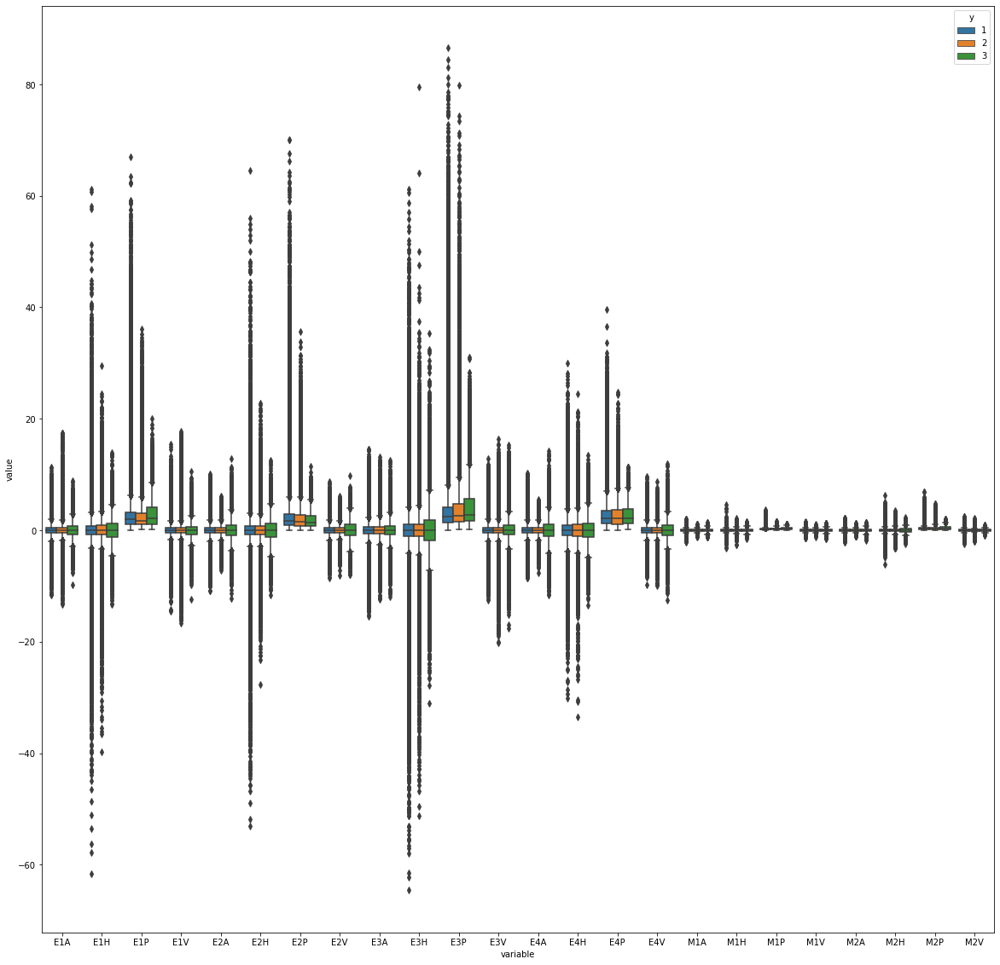

In [123]:
plt.figure(figsize=(20,20))
df_boxplot = df.drop(columns=df.columns[0:4]).melt(id_vars='y')
df_boxplot.variable = df_boxplot.variable.str.extract(r'(\w\d\w)\d{1,4}')

sns.boxplot(data=df_boxplot,
            x='variable',
            y='value',
            hue='y')

In [102]:
data_1=np.array([[1]+list(x.iloc[0,i].values) for i in region_index])
data_2=np.array([[2]+list(x.iloc[1,i].values) for i in region_index])

data=np.concatenate((data_1,data_2),axis=0)
data=pd.DataFrame(data)
data=data.T
data

,0,1,2,3,4,5,6,7,8,9,...,38,39,40,41,42,43,44,45,46,47
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
1,-0.004708,-0.078098,0.782256,0.019965,0.038280,-0.023775,0.646133,0.042662,-0.039205,-0.202681,...,2.356334,-0.313811,-0.011027,0.163722,0.267650,0.455201,-0.380772,0.034160,0.347833,0.353359
2,-0.031715,0.143586,0.795172,-0.042944,0.022807,-0.111910,0.738934,0.067738,-0.016054,-0.067199,...,4.395575,1.906546,0.197999,0.178099,0.291669,0.303911,-0.347859,-0.625661,0.384971,0.209789
3,-0.080441,0.058254,0.746190,-0.092190,0.093837,0.252766,0.794558,0.121946,-0.023112,0.088773,...,4.079308,2.348165,0.586545,0.350942,0.233532,-0.333604,-0.105241,0.033273,0.370495,0.134944
4,-0.112394,0.014026,0.830530,-0.114548,-0.072557,0.224539,0.764342,0.129953,-0.009641,0.155041,...,4.827264,-0.655727,0.542307,-0.166725,0.212189,-0.099208,-0.331878,-0.421795,0.234321,-0.141928
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2044,-0.015346,-0.136587,0.628558,-0.006989,-0.064247,-0.004474,0.747587,-0.053387,-0.000516,0.000804,...,3.355209,0.935499,0.278015,-0.487912,0.597357,-0.326795,0.007330,0.043038,0.518481,-0.338329
2045,0.014424,-0.047885,0.643359,0.021630,-0.052483,-0.041452,0.706465,-0.031678,0.098873,-0.098995,...,3.923319,-1.633484,-0.094402,0.053700,0.426511,-0.284208,-0.101339,-0.047453,0.621351,-0.067551
2046,-0.003521,-0.028004,0.752428,0.009775,0.027378,0.052927,0.803128,-0.023670,0.079654,-0.026014,...,4.214162,-2.145380,-0.388137,0.165658,0.433058,0.250379,0.369151,0.433964,0.626481,0.095053
2047,0.030748,0.023240,0.721826,-0.017280,0.081674,0.098760,0.787472,-0.024213,0.032118,-0.080568,...,3.675274,-0.038404,-0.545897,-0.269299,0.347574,0.358847,0.448982,-0.260936,0.497237,-0.309445


In [106]:
data.melt(id_vars=0)

,variable,value
0,0,1.000000
1,0,-0.004708
2,0,-0.031715
3,0,-0.080441
4,0,-0.112394
...,...,...
2044,0,-0.015346
2045,0,0.014424
2046,0,-0.003521
2047,0,0.030748


In [97]:
data.rename(columns={0:'Y'},inplace=True)
data

,Y,1,2,3,4,5,6,7,8,9,...,2039,2040,2041,2042,2043,2044,2045,2046,2047,2048
0,1.0,-0.004708,-0.031715,-0.080441,-0.112394,-0.070905,-0.023779,0.057110,0.095892,0.054590,...,-0.040941,-0.066183,-0.045965,-0.011207,0.003050,-0.015346,0.014424,-0.003521,0.030748,0.057742
1,1.0,-0.078098,0.143586,0.058254,0.014026,0.027708,-0.087951,-0.040681,0.049996,0.189980,...,0.104500,-0.014600,0.049084,-0.062362,0.018237,-0.136587,-0.047885,-0.028004,0.023240,0.002836
2,1.0,0.782256,0.795172,0.746190,0.830530,0.866019,0.778579,0.653463,0.732856,0.668671,...,0.864064,0.837537,0.809754,0.801707,0.723523,0.628558,0.643359,0.752428,0.721826,0.706305
3,1.0,0.019965,-0.042944,-0.092190,-0.114548,-0.097837,-0.022421,-0.003306,0.086677,0.126990,...,0.034494,0.005005,-0.026420,-0.047061,-0.029259,-0.006989,0.021630,0.009775,-0.017280,-0.071917
4,1.0,0.038280,0.022807,0.093837,-0.072557,-0.055704,-0.102484,-0.046239,-0.002175,-0.028195,...,-0.000693,0.046561,0.035664,0.062646,-0.005578,-0.064247,-0.052483,0.027378,0.081674,0.059778
5,1.0,-0.023775,-0.111910,0.252766,0.224539,-0.071992,-0.005771,-0.091841,-0.121697,-0.029658,...,0.083503,0.009758,0.091917,-0.029003,-0.016896,-0.004474,-0.041452,0.052927,0.098760,-0.081709
6,1.0,0.646133,0.738934,0.794558,0.764342,0.761030,0.841101,0.904411,0.765965,0.785107,...,0.719731,0.761520,0.798681,0.680509,0.703452,0.747587,0.706465,0.803128,0.787472,0.807281
7,1.0,0.042662,0.067738,0.121946,0.129953,0.040964,-0.053365,-0.100443,-0.040067,-0.013094,...,0.134491,0.121227,0.052800,-0.030614,-0.054231,-0.053387,-0.031678,-0.023670,-0.024213,0.000539
8,1.0,-0.039205,-0.016054,-0.023112,-0.009641,-0.001500,-0.062192,0.024439,0.087894,0.081586,...,0.015362,0.057319,-0.049995,-0.028874,-0.107234,-0.000516,0.098873,0.079654,0.032118,-0.061214
9,1.0,-0.202681,-0.067199,0.088773,0.155041,0.276208,-0.338896,0.130319,0.077645,-0.068993,...,-0.217751,0.074057,0.066872,0.044857,0.228898,0.000804,-0.098995,-0.026014,-0.080568,-0.115665


In [100]:

sns.boxplot(data=data.T.melt(id_vars='Y'), x='variable', y='value',hue='Y',orient='v')

KeyError: 'Y'

In [99]:
data.melt(id_vars='Y')



,Y,variable,value
0,1.0,1,-0.004708
1,1.0,1,-0.078098
2,1.0,1,0.782256
3,1.0,1,0.019965
4,1.0,1,0.038280
...,...,...,...
98299,2.0,2048,0.173786
98300,2.0,2048,0.350305
98301,2.0,2048,0.278099
98302,2.0,2048,0.265985


In [119]:
plt.figure(figsize=(600,600))
c=1
for i,j in enumerate(id_1):



    x=df_2.loc[(j)]
   
    plt.subplot(4,2,c)
    c+=1
    x.iloc[0,:][1::].plot()
    plt.subplot(4,2,c)
    c+=1
    x.iloc[1,:][1::].plot()


    if i==3:
        break


    


In [99]:
df_2.loc[(id_1[0])]

,id,E1A1,E1A2,E1A3,E1A4,E1A5,E1A6,E1A7,E1A8,E1A9,...,M2V2039,M2V2040,M2V2041,M2V2042,M2V2043,M2V2044,M2V2045,M2V2046,M2V2047,M2V2048
y,,,,,,,,,,,,,,,,,,,,,
1,523.75,-0.004708,-0.031715,-0.080441,-0.112394,-0.070905,-0.023779,0.057110,0.095892,0.054590,...,-0.008467,0.034058,0.075859,0.054737,0.020403,0.020816,0.032297,0.064164,0.029558,-0.018550
2,108.00,-1.923729,-0.233395,-0.930188,-0.334518,0.268439,0.804236,-1.160246,-1.011909,-2.526402,...,-0.380091,0.004535,0.004462,-0.290558,-0.531270,-0.338329,-0.067551,0.095053,-0.309445,-0.024472


In [98]:
id[0]

'LHCB-4,QSCB-4-CP1'

In [60]:
id=df_2.index

<AxesSubplot:>

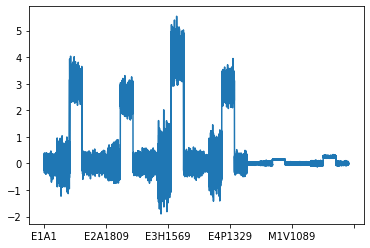

In [67]:
df_2.loc[id[3]][1::].plot()

<AxesSubplot:>

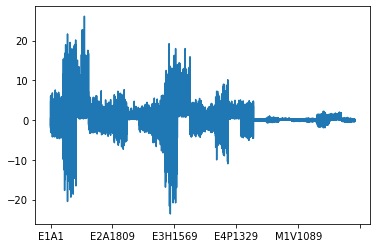

In [68]:
df_2.loc[id[4]][1::].plot()

<AxesSubplot:>

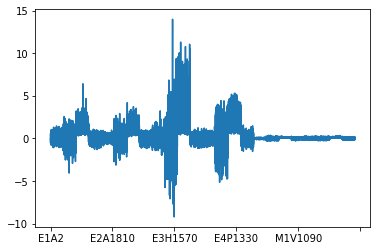

In [120]:
df.iloc[5,6:].plot()